In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import preprocessing

pd.set_option('display.max_rows', None)


In [2]:
guide_path = '/Users/garcial/My_documents/Personal documents/S2DS_course/FSA_project/Data/food survey/withGuide_Food+and+You+Waves+1-5+Data+User+Guide.xlsx'

# Create a dictionary of question names
questions_dict = pd.read_excel(guide_path, 'Variables')
questions_dict = pd.Series(questions_dict.Label.values, index=questions_dict.Variable).to_dict() #OR: dict(zip(questions_dict.Variable, questions_dict.Label))
#print(questions_dict)

# Create a nested dictionary of answer names
answers_dict = pd.read_excel(guide_path, 'Values')
answers_dict['Label'] = answers_dict['Label'].replace({'Wave 1': 2010, 'Wave 2': 2012, 'Wave 3': 2014, 'Wave 4': 2016, 'Wave 5': 2018})
answers_dict = answers_dict.fillna(method='ffill')
answers_dict = answers_dict.groupby('Variable')[['Vlue', 'Label']].apply(lambda g: dict(g.values)).to_dict()
#print(answers_dict)

In [3]:
# Load F&Y survey dataset

data_path = '/Users/garcial/My_documents/Personal documents/S2DS_course/FSA_project/Data/food survey/Food+and+You+Waves+1-5+Data (3).csv'
data = pd.read_csv(data_path)
data = pd.DataFrame(data)

# Encode 'Not applicable', 'Refused' and 'Don't know' as NaN
data = data.replace([-9, -8, -1, 98], np.nan)
cols_5_NaN = ['q4_1_4', 'q4_1_5a', 'Q4_1_5_comb', 'q4_1_6', 'q4_1_7', 'q4_1_8a', 'q4_1_8b', 'sanspray', 'q4_1_11',
              'q4_1_12', 'q4_1_13', 'q4_1_14', 'q4_1_15', 'q4_1_16', 'q4_1_17', 'q4_1_18', 'q4_1_19']
data[cols_5_NaN] = data[cols_5_NaN].replace([5], np.nan)


## To see hoy many non-NaNs values each column has
#print(data.count())

## To code NaNs as a number (-1)
#data[np.isnan(data)] = -1  # Or find a better way to impute missing values

## To see the full question label (column name), instead of the short version: use questions_dict
#data = data.rename (columns = questions_dict)

## To see the full answer label (cell values), instead of the numbers: use answers_dict
#data = data.replace(answers_dict) # It is a slow process, but will work

#data.shape
data.head()


## Not advisable probably, but if we want to exclude those columns that are all NaNs:
# data = data.dropna(axis='columns', how='all')

,SerialNo,RespSex,age_dv,bhhsize2,below6,below16,marstat2,hhdinc,workstat2,region_dv,...,Label,FdAuthAct_MC1,FdAuthAct_MC2,FdAuthAct_MC3,FdAuthAct_MC4,FdAuthAct_MC5,FdAuthAct_MC6,FdAuthAct_MC7,FdAuthAct_MC8,FdAuthAct_MC9
0,100002,1,NaN,NaN,NaN,2.0,2.0,4.0,NaN,12,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,100006,1,NaN,NaN,NaN,1.0,1.0,2.0,NaN,7,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,100018,2,NaN,NaN,NaN,2.0,1.0,4.0,NaN,12,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,100019,1,NaN,NaN,NaN,2.0,2.0,NaN,NaN,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,100027,2,NaN,NaN,NaN,1.0,1.0,3.0,NaN,10,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


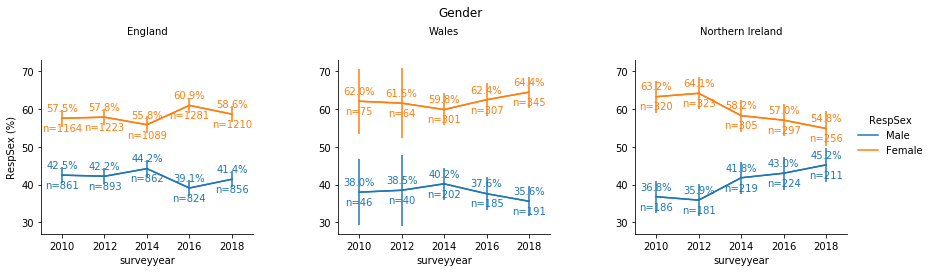

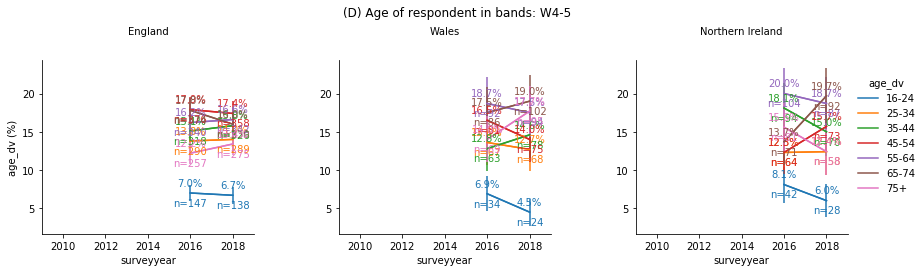

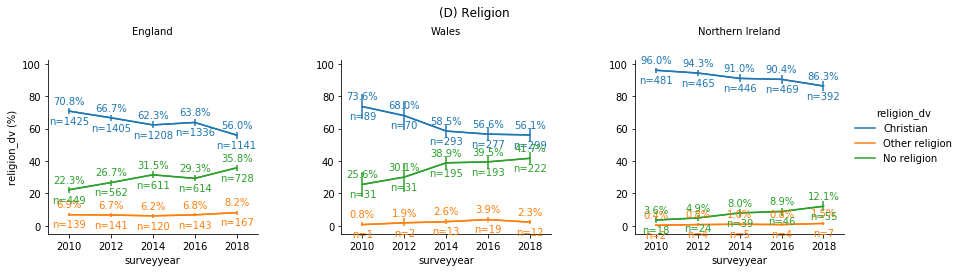

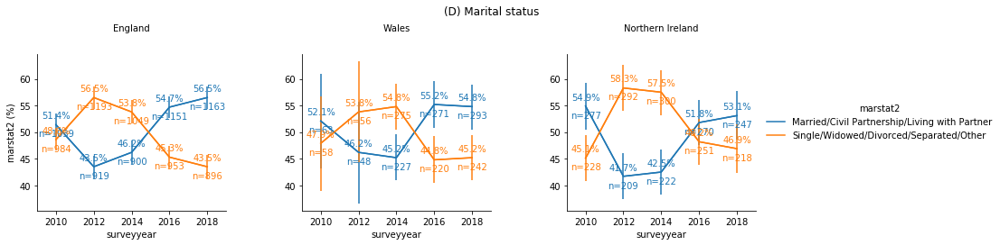

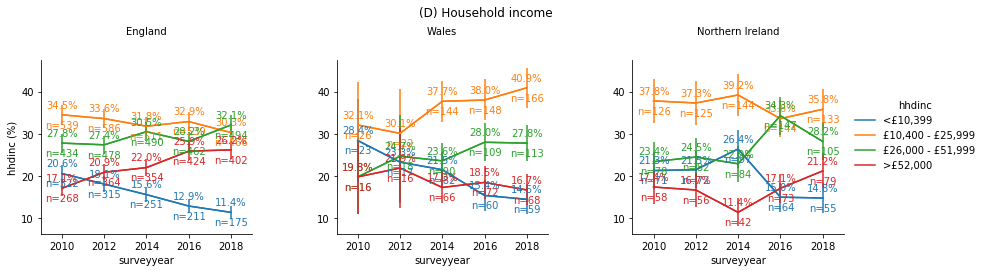

...

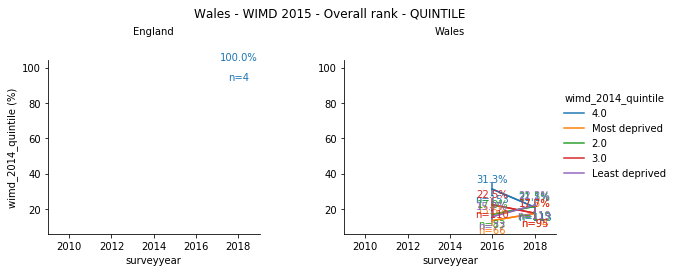

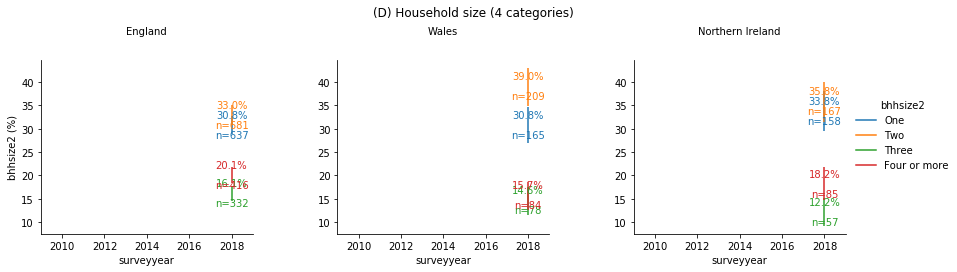

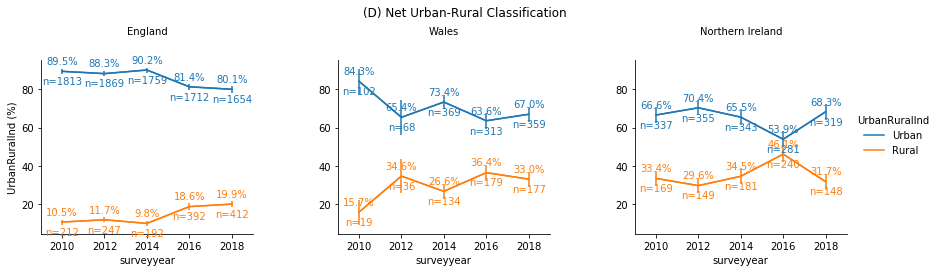

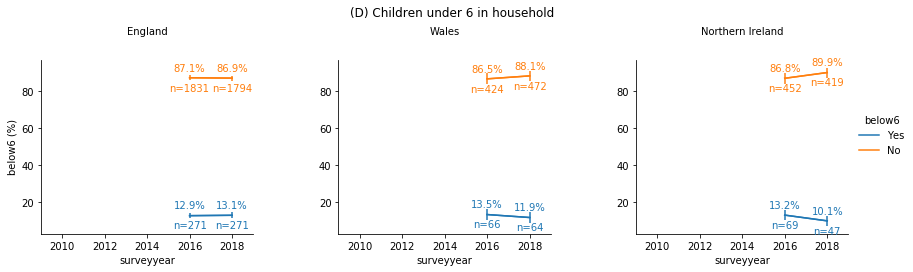

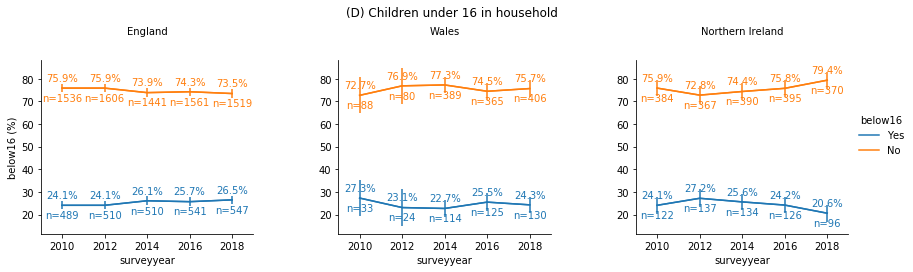

In [6]:
# Custom function for plotting.
# It specifies the % number on top and the count number below.
# I double checked it handles well preceding NaNs values (sns.pointplot doesn't handle this well)
def f(x,y,z, **kwargs):
    ax = sns.lineplot(x,y,**kwargs)
    for i in range(len(x)):
        ax.annotate(str(y.values[i]) + '%', xy=(x.values[i], y.values[i]),fontsize=10,
                    xytext = (0,10), textcoords="offset points",
                color=kwargs.get("color","k"), 
                va='center', ha='center')
    for i in range(len(x)):
        ax.annotate('n=' + str(z.values[i]), xy=(x.values[i], y.values[i]),fontsize=10,
                    xytext = (0,-10), textcoords="offset points",
                color=kwargs.get("color","k"), 
                va='center', ha='center')

# Define a wrapper function for plt.errorbar
def errorbar(x, y, low, high,  color, **kws):
    plt.errorbar(x, y, (y - low, high - y), color=color)

# Define a wrapper function for plt.errorbar (for categorical variable in x)
#def errorbar(x, y, low, high, order, color, **kws):
#    xnum = [order.index(x_i) for x_i in x]
#    plt.errorbar(xnum, y, (y - low, high - y), color=color)

####################################################################################

# Make faceted (for example, different regions plotted in different plots) temporal line plots
# Line colour is specific to answer value

demographic = ['RespSex', 'age_dv', 'religion_dv', 'marstat2', 'hhdinc', 'workstat2', 'wimd_2014_quintile', 'bhhsize2',
               'UrbanRuralInd', 'below6', 'below16']

# Select data of interest for a particular plot (that doesn't need table pivoting)
temp = data[demographic + ['country_dv','region_dv', 'surveyyear']]

# Select Wales region (can consider analysing other regions too)
#data_wales = data[data.region_dv.eq(10)]

# Differentiate Wales values vs Rest of UK values (for example)
#temp.loc[temp.region_dv != 10, 'region_dv'] = 0

#temp = temp.replace(answers_dict)

  
from matplotlib.backends.backend_pdf import PdfPages
import statsmodels.stats.proportion as smp

pdf = PdfPages('demographics_FY_survey.pdf')

figures = []

for demographic_variable in demographic:
    
    temp = data[demographic + ['country_dv','region_dv', 'surveyyear']]

    # Group according to the features of interest and calculate the % of answer types for the main target feature
    temp = temp.groupby(['country_dv','surveyyear', demographic_variable])[demographic_variable].agg(['count'])
    temp['total'] = temp.groupby(['country_dv','surveyyear'])['count'].sum()
    lower, upper = smp.proportion_confint (temp['count'], temp['total'], alpha=0.05, method='normal')
    temp['CI_prop_upper'] = upper
    temp['CI_prop_lower'] = lower
    temp[demographic_variable + ' (%)'] = temp['count'] / temp['total'] * 100
    temp['CI_perc_upper'] = temp['CI_prop_upper'] * 100
    temp['CI_perc_lower'] = temp['CI_prop_lower'] * 100
    temp.reset_index(inplace=True) # To 'undo' the grouping
    temp = temp.round(1)
    
    # Recode the answers of those variables we want to use to stratify the population
    answers_to_rename = ['country_dv', demographic_variable, 'surveyyear']
    temp[answers_to_rename] = temp[answers_to_rename].replace(answers_dict)
    temp

    # Plot features of interest from the created 'temp' subset
    g = sns.FacetGrid(temp, col='country_dv', hue=demographic_variable, height=4, aspect=1) # col='religion_dv',
    #order = sns.utils.categorical_order(temp['surveyyear'])
    g.map(errorbar, 'surveyyear', demographic_variable + ' (%)', 'CI_perc_lower', 'CI_perc_upper') # , order=order
    g = (g.map(f, 'surveyyear', demographic_variable + ' (%)', 'count')
         .add_legend())
    #plt.ylim(0, 100)
    plt.xlim(2009, 2019)
    g.set_titles('{col_name}', pad = 25) # '{row_name}' ' | ' '{col_name}'
    plt.subplots_adjust(hspace=0.4, wspace=0.4, top=0.75)
    for ax in g.axes.flatten():
        ax.tick_params(labelbottom=True, labelleft=True)
    plt.figtext(.5,.9, questions_dict.get(demographic_variable), fontsize=12, ha='center')
    
    figures += [g.fig]

for figure in figures:
    pdf.savefig(figure)
pdf.close()


In [174]:
temp

,country_dv,surveyyear,below16,count,total,CI_prop_upper,CI_prop_lower,below16 (%),CI_perc_upper,CI_perc_lower
0,England,2010,Yes,489,2025,0.3,0.2,24.1,26.0,22.3
1,England,2010,No,1536,2025,0.8,0.7,75.9,77.7,74.0
2,England,2012,Yes,510,2116,0.3,0.2,24.1,25.9,22.3
3,England,2012,No,1606,2116,0.8,0.7,75.9,77.7,74.1
4,England,2014,Yes,510,1951,0.3,0.2,26.1,28.1,24.2
5,England,2014,No,1441,1951,0.8,0.7,73.9,75.8,71.9
6,England,2016,Yes,541,2102,0.3,0.2,25.7,27.6,23.9
7,England,2016,No,1561,2102,0.8,0.7,74.3,76.1,72.4
8,England,2018,Yes,547,2066,0.3,0.2,26.5,28.4,24.6
9,England,2018,No,1519,2066,0.8,0.7,73.5,75.4,71.6


In [ ]:
# Select Wales region (can consider analysing other regions too)
data_wales = data[data.region_dv.eq(10)]

# Specify which waves to focus on
wave = [5]
data_wales = data_wales.loc[data_wales['surveyyear'].isin(wave)]

## To code NaNs as a number (-1)
data_wales[np.isnan(data_wales)] = -1 # Or find a better way to impute missing values

# Find out which columns show a constant value
constants = data_wales.columns[data_wales.nunique() <= 1]
print(constants)

# Remove columns that show a constant value
data_wales = data_wales.loc[:, (data_wales != data_wales.iloc[0]).any()] 

#data_wales



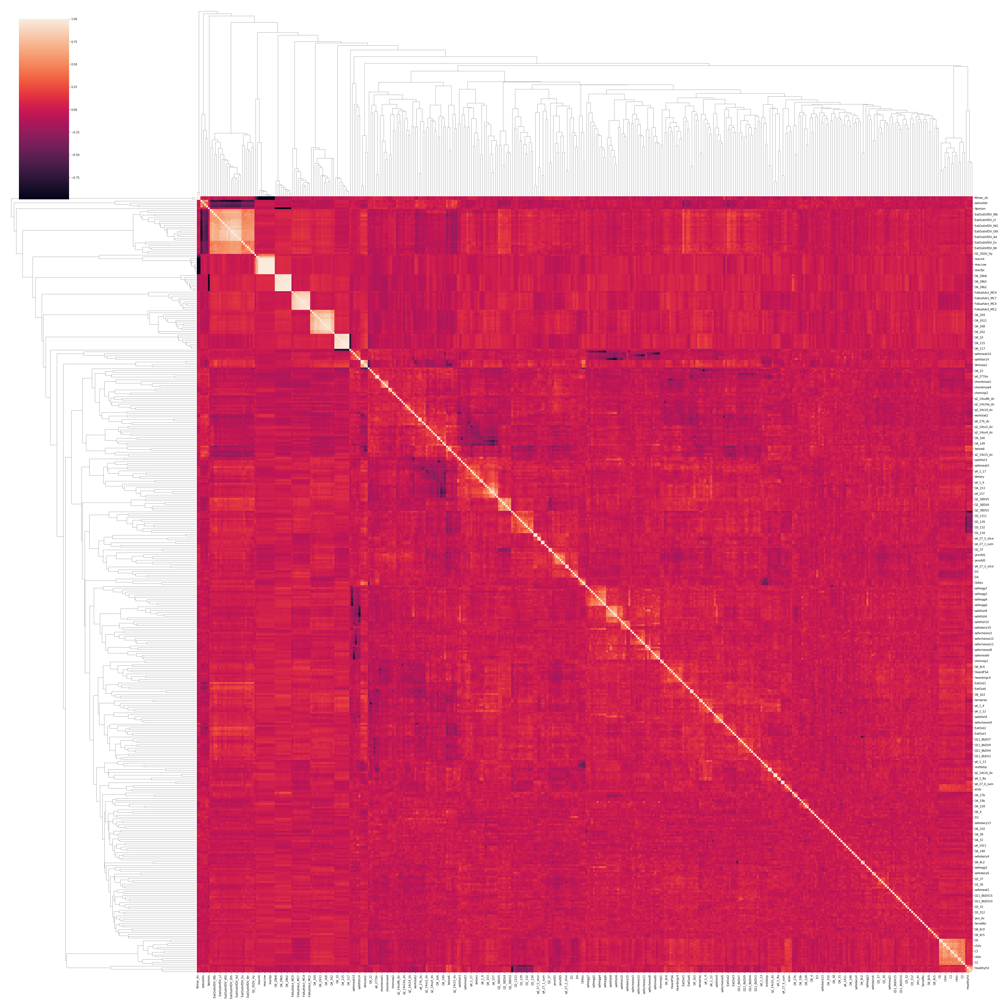

In [6]:
# The hierarchical clustering will take a while to run.
# May need to install fastcluster to make this work
g = sns.clustermap(data_wales.corr(method='spearman'), figsize=(50, 50)) # This figsize is too small, but works fast

# To save the clustering created
g.savefig('cluster_question_wales_w5.png', format = 'png',  dpi = 300)

#g.dendrogram_col.linkage

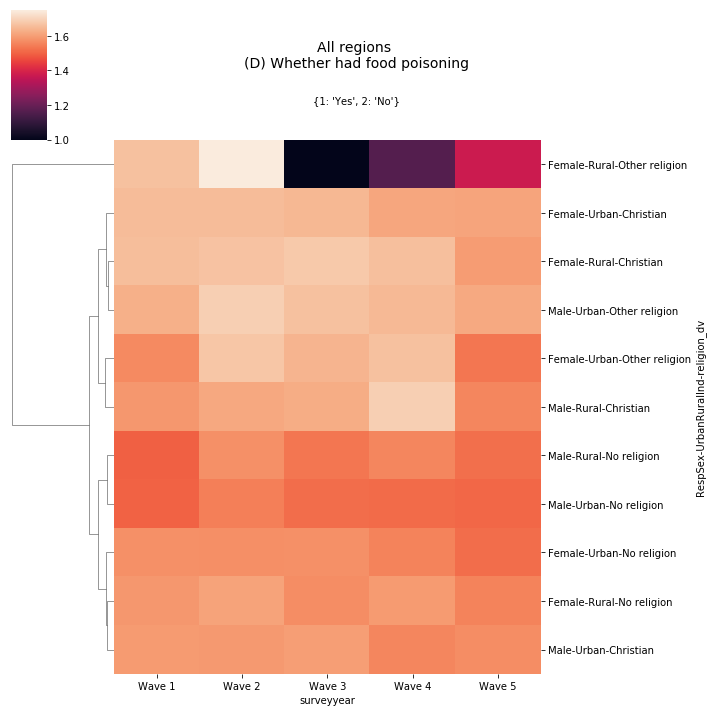

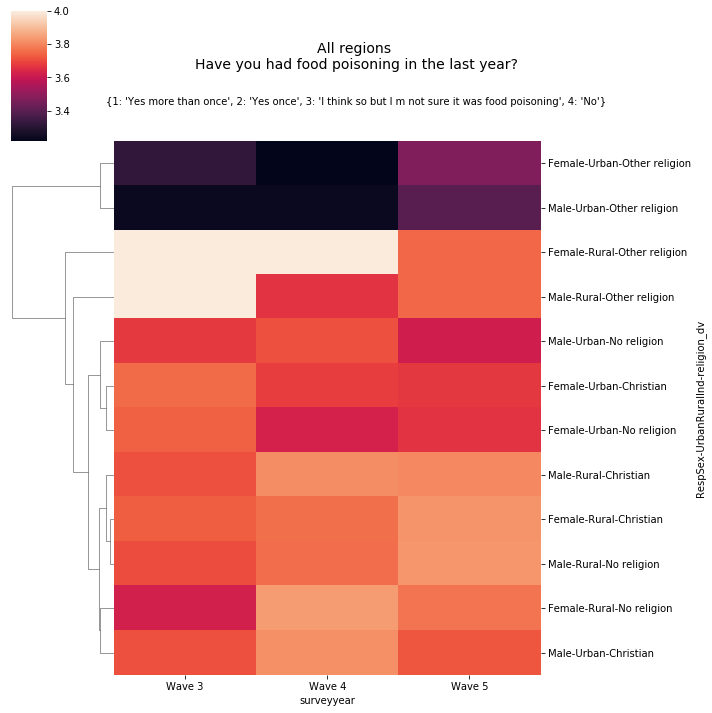

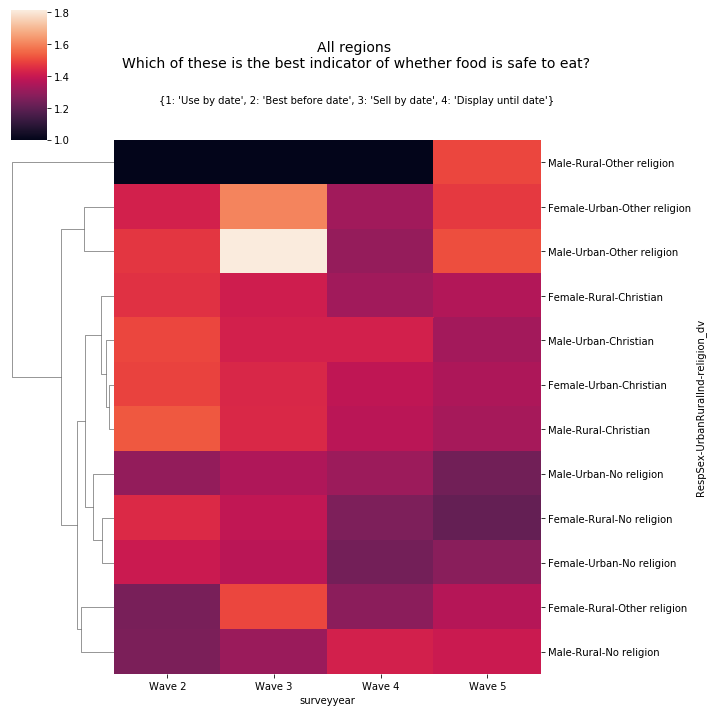

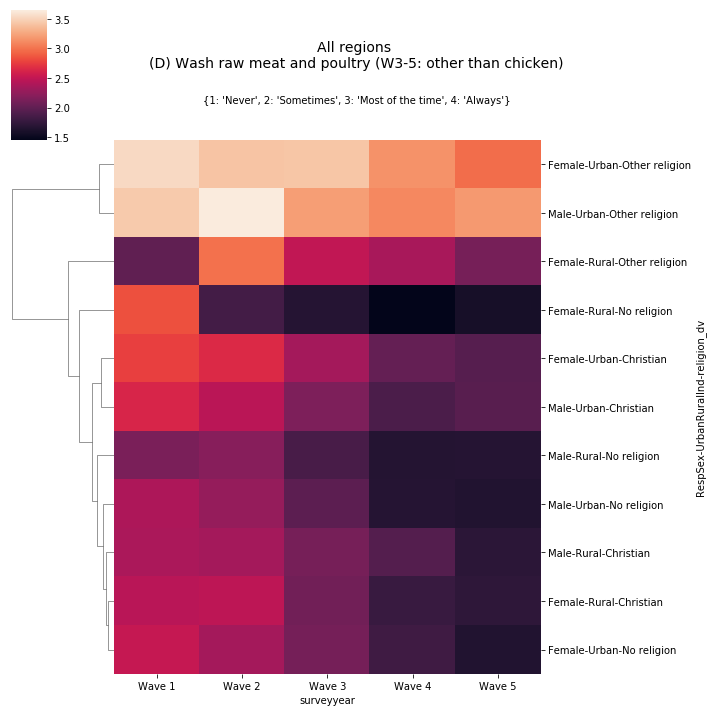

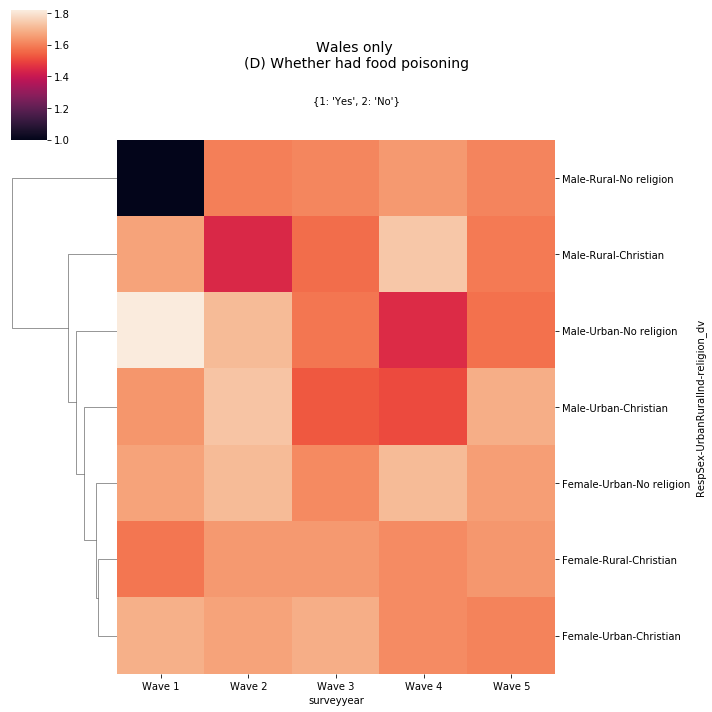

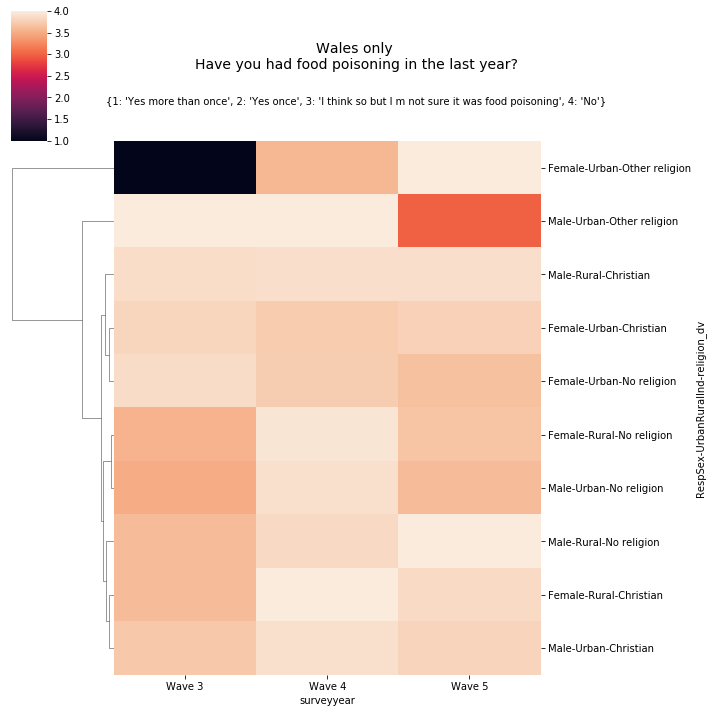

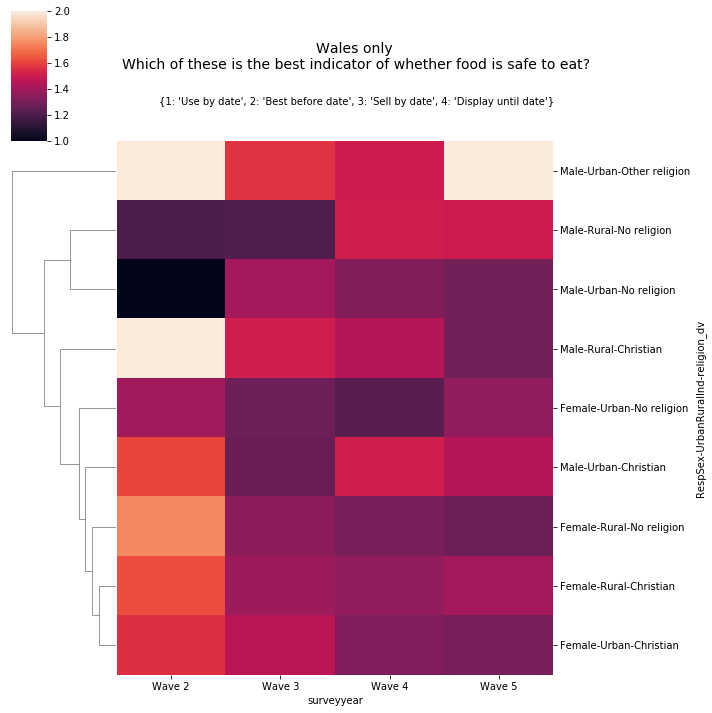

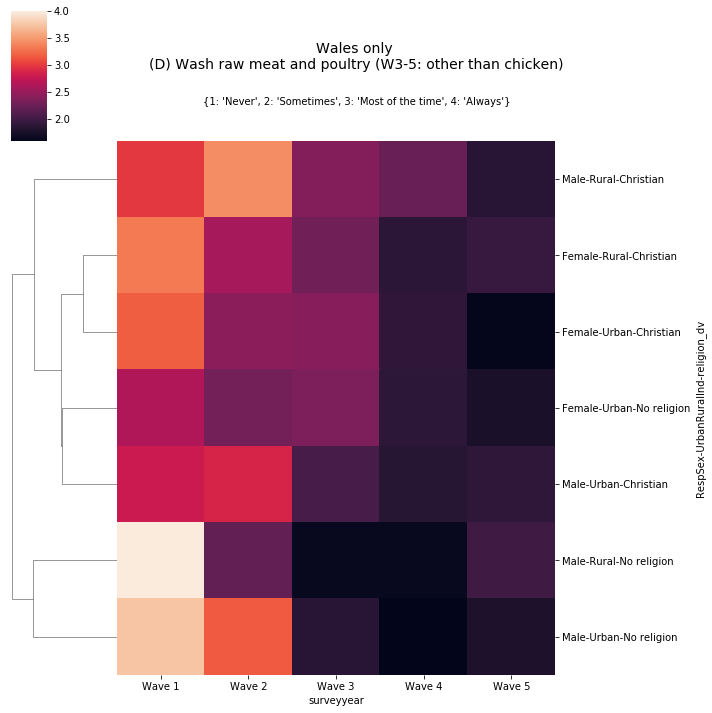

In [8]:
# Hierarchical clustering heatmaps showing the values of a chosen variable (instead of the variables' correlation)

# Specify which waves to focus on
wave = [1,2,3,4,5]
data_waves = data.loc[data['surveyyear'].isin(wave)]

# Recode the answers of those variables we want to use to stratify the population
answers_to_rename = ['RespSex','UrbanRuralInd', 'religion_dv', 'surveyyear'] # hhdinc, age_dv, wimd_2014_quintile
data_waves[answers_to_rename] = data_waves[answers_to_rename].replace(answers_dict)

# Target variables of interest (list to be extended):
# bpoison = (D) Whether had food poisoning
# Q4_26b = Have you had food poisoning in the last year?
# Q4_19b = Which of these is the best indicator of whether food is safe to eat?
# Q4_1_5_comb = (D) Wash raw meat and poultry (W3-5: other than chicken)

variables_to_plot = ['bpoison', 'Q4_26b', 'Q4_19b', 'Q4_1_5_comb']

###############

# Plot data for all regions (for example):

for values_to_plot in variables_to_plot:
    
    # To mention in plot the possible answer for the chosen question (ignoring those answers that are coded as NaN)
    answers_dict_chosen = answers_dict[values_to_plot].copy()
    remove_list = [-9, -8, -1]
    for key in remove_list:
        answers_dict_chosen.pop(key)
    if values_to_plot in cols_5_NaN:
        answers_dict_chosen.pop(5)
    if 98 in answers_dict_chosen:
        answers_dict_chosen.pop(98)
    
    heatmap_data = data_waves.pivot_table(values=values_to_plot,
                                          index=['RespSex','UrbanRuralInd', 'religion_dv'],
                                          columns='surveyyear')
    heatmap_data = heatmap_data.dropna(how='any') # Removes rows with any na
    #heatmap_data
    sns.clustermap(heatmap_data, col_cluster=False)
    
    plt.figtext(.5,.9, 'All regions \n' + questions_dict[values_to_plot], fontsize=14, ha='center')
    plt.figtext(.5,.85, answers_dict_chosen, fontsize=10, ha='center')

###############

# Plot data for Wales only:

data_wales = data_waves[data_waves.region_dv.eq(10)]


for values_to_plot in variables_to_plot:
    
    # To mention in plot the possible answer for the chosen question (ignoring those answers that are coded as NaN)
    answers_dict_chosen = answers_dict[values_to_plot].copy()
    remove_list = [-9, -8, -1]
    for key in remove_list:
        answers_dict_chosen.pop(key)
    if values_to_plot in cols_5_NaN:
        answers_dict_chosen.pop(5)
    if 98 in answers_dict_chosen:
        answers_dict_chosen.pop(98)
    
    heatmap_data = data_wales.pivot_table(values=values_to_plot,
                                          index=['RespSex','UrbanRuralInd', 'religion_dv'],
                                          columns='surveyyear')
    heatmap_data = heatmap_data.dropna(how='any') # Removes rows with any na
    #heatmap_data
    sns.clustermap(heatmap_data, col_cluster=False)
    
    plt.figtext(.5,.9, 'Wales only \n' + questions_dict[values_to_plot], fontsize=14, ha='center')
    plt.figtext(.5,.85, answers_dict_chosen, fontsize=10, ha='center')

#g.savefig('fig_name.png', format = 'png',  dpi = 300)


# To avoid cells with missing values being shown with the colour of the lowest level of correlation
#mask = heatmap_data.isnull()
#sns.heatmap(heatmap_data, mask=mask)

In [10]:
# Standarization (MinMaxScaler). Mostly optional

x = data.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
data_scaled = pd.DataFrame(x_scaled)
# also: normalized_df=(df-df.min())/(df.max()-df.min())

# To see the column label, instead of the index
#data_scaled.columns = list(data.columns) # Might need to be re-done now

# To see the full column name, instead of the label (using the dictionary questions_dict)
# data_scaled = data_scaled.rename (columns = questions_dict) # Might need to be re-done now

#data.shape
data_scaled.head()

# Ignore the red block that appears in Jupyter notebooks. It is just a common warning

,0,1,2,3,4,5,6,7,8,9,...,492,493,494,495,496,497,498,499,500,501
0,0.000000,0.0,NaN,NaN,NaN,1.0,1.0,1.000000,NaN,1.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.000010,0.0,NaN,NaN,NaN,0.0,0.0,0.333333,NaN,0.545455,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.000039,1.0,NaN,NaN,NaN,1.0,0.0,1.000000,NaN,1.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.000041,0.0,NaN,NaN,NaN,1.0,1.0,NaN,NaN,0.090909,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.000060,1.0,NaN,NaN,NaN,0.0,0.0,0.666667,NaN,0.818182,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
# To generate new columns by aggregating similar columns together (should only be done after standarization)

#To see the column label, instead of the index
data_scaled.columns = list(data.columns)

def find_variables_topic (chosen_topic, data): # chosen_topic must be a string (eg 'safediary')
    topic = [col for col in data.columns if chosen_topic in col]
    data[chosen_topic] = data[topic].sum(axis=1)
# Example:
    # meat = [col for col in data_wales_scaled.columns if 'safemeat' in col]
    # data_wales_scaled['safemeat'] = data_wales_scaled[meat].sum(axis=1)

topic_list = ['safe', 'safemeat', 'safedairy', 'safeegg', 'safecheese', 'safefish']

for topic in topic_list:
    find_variables_topic (topic, data_scaled)

poison = ['bpoison', 'Q4_26b', 'Q4_28a']
data_scaled['poison_all'] = data_scaled[poison].sum(axis=1)
# mistake? poison_all = 1 most of the time

# To see the full column name, instead of the label (using the dictionary questions_dict)
data_scaled = data_scaled.rename (columns = questions_dict)

data_scaled


,Serial Number,Gender,(D) Age of respondent in bands: W4-5,(D) Household size (4 categories),(D) Children under 6 in household,(D) Children under 16 in household,(D) Marital status,(D) Household income,(D) Working Status (3 categories),(D) Region,...,Stopped eating certain foods,Other (specify),Took no action,safe,safemeat,safedairy,safeegg,safecheese,safefish,poison_all
0,0.000000,0.0,NaN,NaN,NaN,1.0,1.0,1.000000,NaN,1.000000,...,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,1.000000
1,0.000010,0.0,NaN,NaN,NaN,0.0,0.0,0.333333,NaN,0.545455,...,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,1.000000
2,0.000039,1.0,NaN,NaN,NaN,1.0,0.0,1.000000,NaN,1.000000,...,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
3,0.000041,0.0,NaN,NaN,NaN,1.0,1.0,NaN,NaN,0.090909,...,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,1.000000
4,0.000060,1.0,NaN,NaN,NaN,0.0,0.0,0.666667,NaN,0.818182,...,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
5,0.000070,1.0,NaN,NaN,NaN,1.0,0.0,0.333333,NaN,0.181818,...,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,1.000000
6,0.000072,1.0,NaN,NaN,NaN,1.0,1.0,0.000000,NaN,0.636364,...,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
7,0.000084,1.0,NaN,NaN,NaN,1.0,0.0,NaN,NaN,0.818182,...,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,1.000000
8,0.000104,0.0,NaN,NaN,NaN,0.0,0.0,0.333333,NaN,0.363636,...,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,1.000000
9,0.000123,0.0,NaN,NaN,NaN,1.0,1.0,0.000000,NaN,1.000000,...,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,1.000000


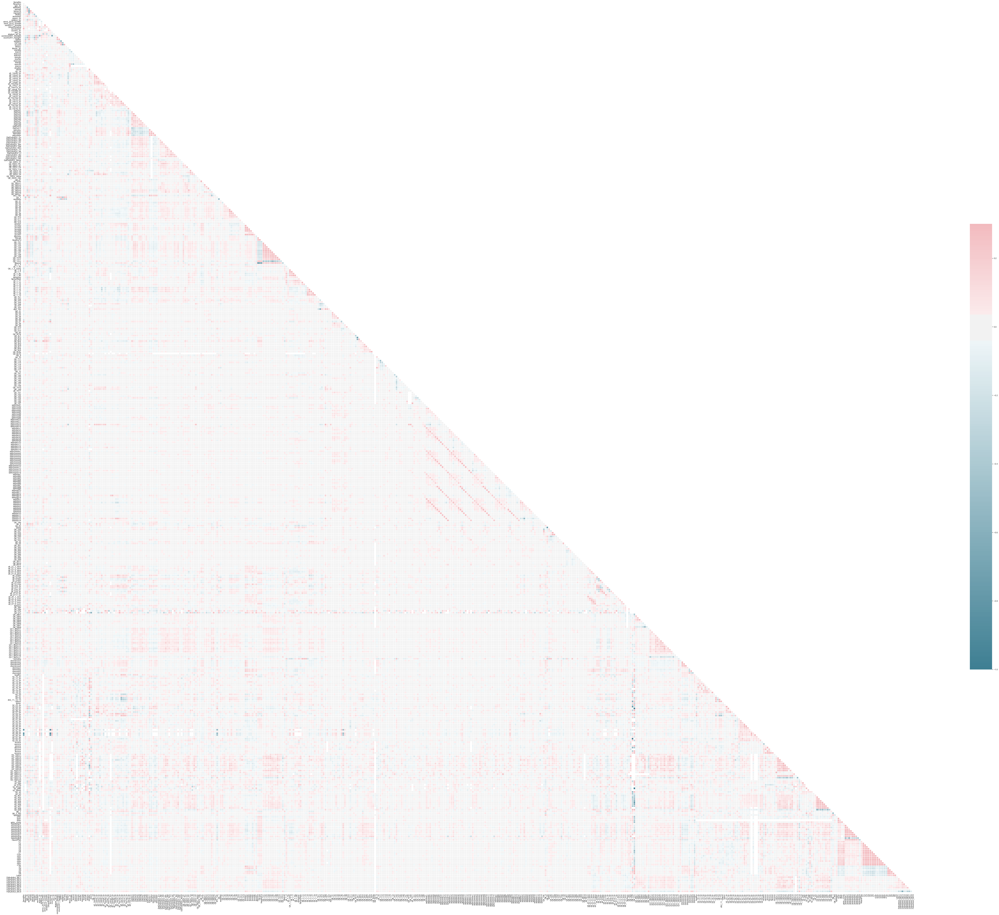

In [12]:
# Generate a plot showing correlation between all original variables

# Correlation matrix between all original variables
corr_matrix = data.corr(method='spearman') # Could also use data_wales_scaled (including new grouped variables)
#print (corr_matrix)


sns.set(style="white")

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr_matrix, dtype = np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(110, 90))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr_matrix, mask=mask, cmap=cmap, vmax=.3, center=0,
            xticklabels=True, yticklabels=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

f.savefig('corr_heatmap_all_variables.png', format = 'png',  dpi = 300)


In [13]:
# Select features highly correlated with output variable

# Correlation  matrix between all variables
cor = data.corr(method='spearman') # Could also use data_wales_scaled (including new grouped variables)

# Correlation with chosen output variable specifically
    # Posible output variables:
    # bpoison = (D) Whether had food poisoning
    # Q4_26b = Have you had food poisoning in the last year?
    # Q4_28a = Did you see a doctor or go to hospital because of it?
from sklearn.feature_selection import RFE
cor_target = cor['Have you had food poisoning in the last year?']

# Select features highly correlated (absolute correlation greater than 0.1)
relevant_features = cor_target[abs(cor_target)>0.1]

relevant_features.sort_values(ascending=False) # This ouput could be saved as a separate file


KeyError: 'Have you had food poisoning in the last year?'

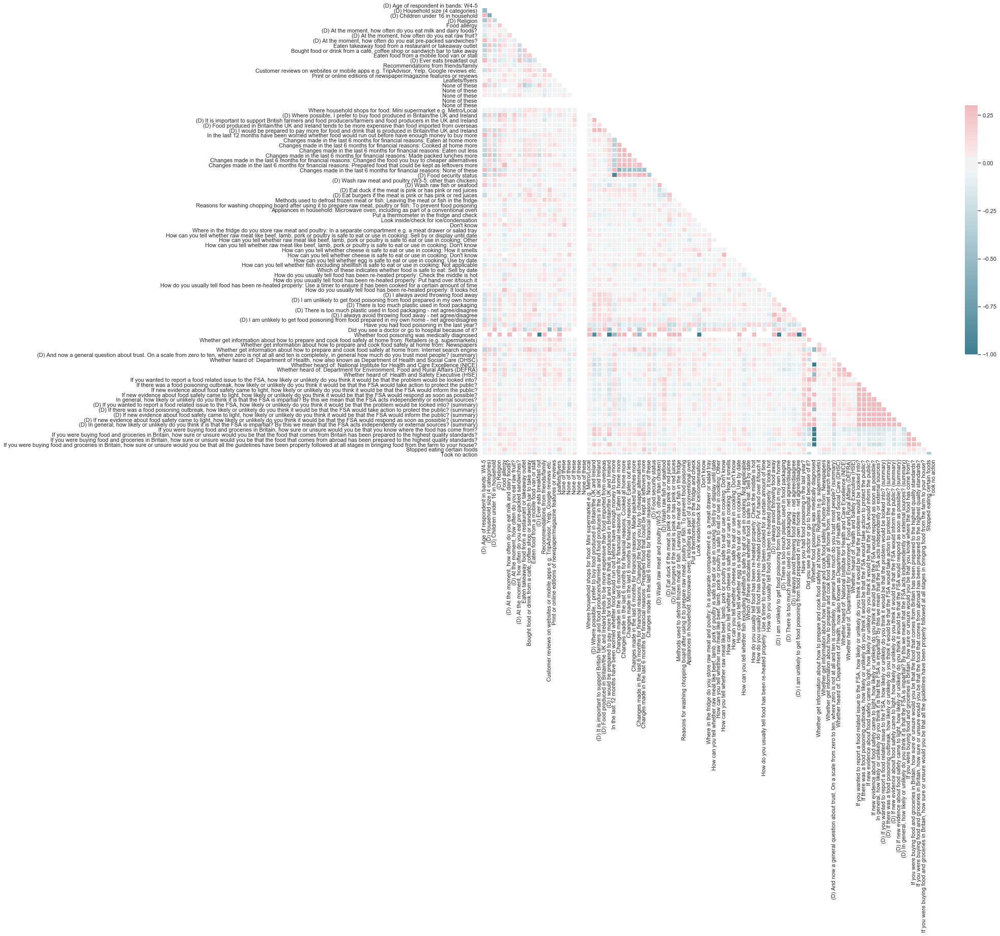

In [472]:
# Generate a plot showing correlation between features highly correlated with output variable

data_correlated_target = data[relevant_features.index]

# Correlation matrix between highly correlated variables
corr_matrix = data_correlated_target.corr(method='spearman') # Could also do this using data_wales_scaled

sns.set(style="white")

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr_matrix, dtype = np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 18))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr_matrix, mask=mask, cmap=cmap, vmax=.3, center=0,
            xticklabels=True, yticklabels=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

f.savefig('corr_heatmap_correlated_target.png', format = 'png',  dpi = 300)


In [ ]:
# Ideas for a predictive model (multi-output classifier)

from sklearn.datasets import make_classification
from sklearn.multioutput import MultiOutputClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.utils import shuffle
import numpy as np

X, y1 = make_classification(n_samples=10, n_features=100, n_informative=30, n_classes=3, random_state=1)
y2 = shuffle(y1, random_state=1)
y3 = shuffle(y1, random_state=2)
Y = np.vstack((y1, y2, y3)).T
n_samples, n_features = X.shape # 10,100
n_outputs = Y.shape[1] # 3
n_classes = 3
forest = RandomForestClassifier(random_state=1)
multi_target_forest = MultiOutputClassifier(forest, n_jobs=-1)
multi_target_forest.fit(X, Y).predict(X)
